## Environment Setup

In [22]:
# def setup_environment():
#   try:
#       # Check if running in Google Colab
#       import google.colab
#       from google.colab import drive
#       drive.mount('/content/drive')
#       folder_path = 'drive/MyDrive/ENSF612Project'
#       print("Running in Google Colab. Folder path:", folder_path)
#   except ImportError:
#       folder_path = '.'
#       print("Running locally: Folder path:", folder_path)
#   return folder_path

# folder_path = setup_environment()

Check that `train.csv` and `test.csv` are visible in the given environment (Note that if running locally, these files must be in the same directory).

In [23]:
# !ls drive/MyDrive/ENSF612Project

In [24]:
# !apt-get install openjdk-8-jdk-headless -qq > /dev/null
# !pip install pyspark

## Spark Initialization

In [25]:
import pyspark
from pyspark.sql import SparkSession

def initialize_spark():
    spark = SparkSession.builder \
        .config("spark.executor.memory", "8g") \
        .config("spark.driver.memory", "8g") \
        .config("spark.driver.host", "127.0.0.1") \
        .config("spark.driver.port", "5001") \
        .getOrCreate()
    sc = spark.sparkContext
    sc.setLogLevel("WARN")
    return spark

spark = initialize_spark()

## Data Loading

In [26]:
folder_path = '.'

def load_data(spark, folder_path, train_file="train.csv", test_file="test.csv"):
    train_df = spark.read.csv(f"{folder_path}/{train_file}", header=True, inferSchema=True)
    test_df = spark.read.csv(f"{folder_path}/{test_file}", header=True, inferSchema=True)
    return train_df, test_df

# Load the data
train_df, test_df = load_data(spark, folder_path)


Inspect Data

In [27]:
test_df.show(10)

+-----+-----------+---------+------------+--------------+--------------+------------------+---------------+--------------------+---------------------+---------------------+-----------------------------+------------------------+------------------------+-----------------------+--------------------+---------+--------------------+--------+---------+--------------------+----+----+----+-----+-----+-------------------+-------------------+-------------------+-------------------+
|MONTH|DAY_OF_WEEK|DEP_DEL15|DEP_TIME_BLK|DISTANCE_GROUP|SEGMENT_NUMBER|CONCURRENT_FLIGHTS|NUMBER_OF_SEATS|        CARRIER_NAME|AIRPORT_FLIGHTS_MONTH|AIRLINE_FLIGHTS_MONTH|AIRLINE_AIRPORT_FLIGHTS_MONTH|AVG_MONTHLY_PASS_AIRPORT|AVG_MONTHLY_PASS_AIRLINE|FLT_ATTENDANTS_PER_PASS|GROUND_SERV_PER_PASS|PLANE_AGE|   DEPARTING_AIRPORT|LATITUDE|LONGITUDE|    PREVIOUS_AIRPORT|PRCP|SNOW|SNWD| TMAX| AWND| CARRIER_HISTORICAL|   DEP_AIRPORT_HIST|     DAY_HISTORICAL|     DEP_BLOCK_HIST|
+-----+-----------+---------+------------+------

In [28]:
train_df.printSchema()

root
 |-- MONTH: integer (nullable = true)
 |-- DAY_OF_WEEK: integer (nullable = true)
 |-- DEP_DEL15: integer (nullable = true)
 |-- DEP_TIME_BLK: string (nullable = true)
 |-- DISTANCE_GROUP: integer (nullable = true)
 |-- SEGMENT_NUMBER: integer (nullable = true)
 |-- CONCURRENT_FLIGHTS: integer (nullable = true)
 |-- NUMBER_OF_SEATS: integer (nullable = true)
 |-- CARRIER_NAME: string (nullable = true)
 |-- AIRPORT_FLIGHTS_MONTH: integer (nullable = true)
 |-- AIRLINE_FLIGHTS_MONTH: integer (nullable = true)
 |-- AIRLINE_AIRPORT_FLIGHTS_MONTH: integer (nullable = true)
 |-- AVG_MONTHLY_PASS_AIRPORT: integer (nullable = true)
 |-- AVG_MONTHLY_PASS_AIRLINE: integer (nullable = true)
 |-- FLT_ATTENDANTS_PER_PASS: double (nullable = true)
 |-- GROUND_SERV_PER_PASS: double (nullable = true)
 |-- PLANE_AGE: integer (nullable = true)
 |-- DEPARTING_AIRPORT: string (nullable = true)
 |-- LATITUDE: double (nullable = true)
 |-- LONGITUDE: double (nullable = true)
 |-- PREVIOUS_AIRPORT: stri

`DEP_TIME_BLK` can be transformed into the numerical feature of hour of departure. Note that only the first two digits are what make the column distinct.

In [29]:
from pyspark.sql.functions import regexp_extract

# Extract the starting hour from the DEP_TIME_BLK column
train_df = train_df.withColumn("DEP_TIME_BLK", regexp_extract("DEP_TIME_BLK", r"(\d{2})", 1).cast("int"))
test_df = test_df.withColumn("DEP_TIME_BLK", regexp_extract("DEP_TIME_BLK", r"(\d{2})", 1).cast("int"))

# Show the transformed DataFrame
train_df.select("DEP_TIME_BLK").distinct().show()
test_df.select("DEP_TIME_BLK").distinct().show()


+------------+
|DEP_TIME_BLK|
+------------+
|          12|
|          22|
|          13|
|          16|
|           6|
|          20|
|          19|
|          15|
|          17|
|           9|
|           8|
|          23|
|           7|
|          10|
|          21|
|          11|
|          14|
|           0|
|          18|
+------------+

+------------+
|DEP_TIME_BLK|
+------------+
|          12|
|          22|
|          13|
|          16|
|           6|
|          20|
|          19|
|          15|
|           9|
|          17|
|           8|
|          23|
|           7|
|          10|
|          21|
|          11|
|          14|
|           0|
|          18|
+------------+



In [30]:
train_df.describe().show()


+-------+------------------+------------------+-------------------+-----------------+------------------+-----------------+------------------+------------------+--------------------+---------------------+---------------------+-----------------------------+------------------------+------------------------+-----------------------+--------------------+------------------+-----------------+-----------------+------------------+--------------------+-------------------+-------------------+-------------------+-----------------+-----------------+-------------------+-------------------+--------------------+-------------------+
|summary|             MONTH|       DAY_OF_WEEK|          DEP_DEL15|     DEP_TIME_BLK|    DISTANCE_GROUP|   SEGMENT_NUMBER|CONCURRENT_FLIGHTS|   NUMBER_OF_SEATS|        CARRIER_NAME|AIRPORT_FLIGHTS_MONTH|AIRLINE_FLIGHTS_MONTH|AIRLINE_AIRPORT_FLIGHTS_MONTH|AVG_MONTHLY_PASS_AIRPORT|AVG_MONTHLY_PASS_AIRLINE|FLT_ATTENDANTS_PER_PASS|GROUND_SERV_PER_PASS|         PLANE_AGE|DEPARTIN

Check the distribution of train/test dataframes

In [31]:
from pyspark.sql.functions import col, count, when

def calculate_distribution(df, target_column):
    # Count total rows
    total_count = df.count()
    
    # Count 1s and 0s in the target column
    distribution = (
        df.groupBy(target_column)
        .count()
        .withColumn("proportion", col("count") / total_count)
    )
    return distribution

# Calculate distributions for train and test DataFrames
train_distribution = calculate_distribution(train_df, "DEP_DEL15")
test_distribution = calculate_distribution(test_df, "DEP_DEL15")

In [32]:
print("Train Data Distribution:")
train_distribution.show()

Train Data Distribution:
+---------+-------+-------------------+
|DEP_DEL15|  count|         proportion|
+---------+-------+-------------------+
|        1| 859158|0.18914423679585624|
|        0|3683185| 0.8108557632041438|
+---------+-------+-------------------+



In [33]:
print("Test Data Distribution:")
test_distribution.show()

Test Data Distribution:
+---------+-------+-------------------+
|DEP_DEL15|  count|         proportion|
+---------+-------+-------------------+
|        1| 368210|0.18914388774137408|
|        0|1578509|  0.810856112258626|
+---------+-------+-------------------+



## Preprocessing Pipeline

In [34]:
from pyspark.ml.feature import StringIndexer, OneHotEncoder, VectorAssembler, StandardScaler
from pyspark.ml import Pipeline

def preprocess_data(train_df, test_df, target_column, numeric_features, string_features):
    # Define stages
    string_indexers = [StringIndexer(inputCol=col, outputCol=f"{col}_index") for col in string_features]
    one_hot_encoders = [OneHotEncoder(inputCol=f"{col}_index", outputCol=f"{col}_one_hot") for col in string_features]
    numeric_assembler = VectorAssembler(inputCols=numeric_features, outputCol="numeric_features")
    scaler = StandardScaler(inputCol="numeric_features", outputCol="numeric_features_scaled", withMean=True, withStd=True)
    label_indexer = StringIndexer(inputCol=target_column, outputCol="label")

    # Pipeline
    stages = string_indexers + one_hot_encoders + [numeric_assembler, scaler, label_indexer]
    pipeline = Pipeline(stages=stages)

    # Fit and transform
    pipeline_model = pipeline.fit(train_df)
    train_transformed = pipeline_model.transform(train_df)
    test_transformed = pipeline_model.transform(test_df)
    return train_transformed, test_transformed

numeric_features = [
    "MONTH",
    "DAY_OF_WEEK",
    "DISTANCE_GROUP",
    "SEGMENT_NUMBER",
    "CONCURRENT_FLIGHTS",
    "NUMBER_OF_SEATS",
    "AIRPORT_FLIGHTS_MONTH",
    "AIRLINE_AIRPORT_FLIGHTS_MONTH",
    "AVG_MONTHLY_PASS_AIRPORT",
    "AVG_MONTHLY_PASS_AIRLINE",
    "FLT_ATTENDANTS_PER_PASS",
    "GROUND_SERV_PER_PASS",
    "PLANE_AGE",
    "LATITUDE",
    "LONGITUDE",
    "PRCP",
    "SNOW",
    "SNWD",
    "TMAX",
    "AWND",
    "CARRIER_HISTORICAL",
    "DEP_AIRPORT_HIST",
    "DAY_HISTORICAL",
    'DEP_TIME_BLK',
    "DEP_BLOCK_HIST"
]
string_features = [
    'CARRIER_NAME',
    'DEPARTING_AIRPORT',
    'PREVIOUS_AIRPORT'
]
train_transformed, test_transformed = preprocess_data(train_df, test_df, "DEP_DEL15", numeric_features, string_features)


## Correlation matrix

- Pairplot took over 14h hours to run. Saved to image (displayed below). Code is commented out to prevent lengthy runtimes.

In [35]:
# import seaborn as sns
# import pandas as pd

# # Sample the DataFrame
# # Dataframe can't be too large to convert to pandas (for visualizing Seaborn Pairplot)
# sampled_df = train_transformed.sample(withReplacement=False, fraction=0.1, seed=42)

# # Convert to pandas DataFrame
# pandas_df = sampled_df.toPandas()

In [36]:
# sns.pairplot(pandas_df, hue="DEP_DEL15", diag_kind="kde")

Some notable plots:
- `DEP_TIME_BLK` has visible separation of classes when combined with `DEP_AIRPORT_HIST`, `DEP_AIRPORT_HIST`, `AWND`, and `SNOW`.
- `DEP_BLOCK_HIST` also shows some visible separation of classes when combined with `CONCURRENT_FLIGHTS`, `PRCP`, `SNOW`, and `PLANE_AGE`.
- `SNOW` generally has higher incidents of the positive class as the amount of snow increases.
- The diagonal plots generally show the same shape (peaks and troughs) for both the positive and negative classes, indicating  that any single feature may not be able to easily distinguish between classes. The strongest difference in trends between the positive class and negative class is again seen by `DEP_TIME_BLK`.
- From the pairplot, it would be unsurprising if `DEP_TIME_BLK` and `DEP_BLOCK_HIST` were the most importantant a highly correlated features that could be used to discriminate between target vector classes.


### Check Correlation of Each Numerical Feature Directly With Target Vector

Correlations with Target (DEP_DEL15):
                               Correlation
DEP_BLOCK_HIST                    0.198331
DEP_TIME_BLK                      0.165519
CARRIER_HISTORICAL                0.121155
SEGMENT_NUMBER                    0.117343
DEP_AIRPORT_HIST                  0.099611
DAY_HISTORICAL                    0.097732
PRCP                              0.080107
AWND                              0.050869
SNOW                              0.050233
LONGITUDE                         0.027445
AIRPORT_FLIGHTS_MONTH             0.026883
SNWD                              0.026275
AVG_MONTHLY_PASS_AIRPORT          0.024386
DISTANCE_GROUP                    0.015998
AIRLINE_AIRPORT_FLIGHTS_MONTH     0.013950
NUMBER_OF_SEATS                   0.011734
CONCURRENT_FLIGHTS                0.009380
PLANE_AGE                         0.006335
AVG_MONTHLY_PASS_AIRLINE          0.001158
LATITUDE                          0.000140
DAY_OF_WEEK                      -0.000030
FLT_ATTENDANTS_P

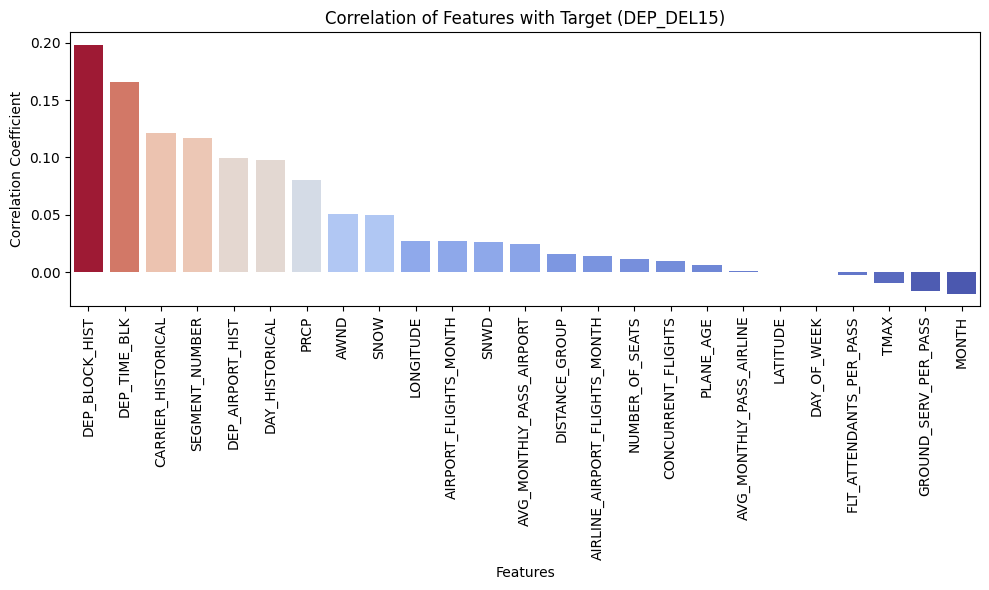

In [37]:
from pyspark.sql.functions import col
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Filter numeric features
selected_features = numeric_features + ["DEP_DEL15"]

# Compute Pearson correlation for numeric features and target separately
correlations = {}
for feature in numeric_features:
    correlation_value = train_df.stat.corr(feature, "DEP_DEL15")
    correlations[feature] = correlation_value

# Convert to pandas DataFrame for easier visualization
correlation_with_target = pd.DataFrame.from_dict(correlations, orient="index", columns=["Correlation"])
correlation_with_target = correlation_with_target.sort_values(by="Correlation", ascending=False)

# Display correlations with the target
print("Correlations with Target (DEP_DEL15):")
print(correlation_with_target)

plt.figure(figsize=(10, 6))
sns.barplot(x=correlation_with_target.index, y=correlation_with_target["Correlation"], palette="coolwarm", hue=correlation_with_target["Correlation"], legend=False)
plt.xticks(rotation=90)
plt.title("Correlation of Features with Target (DEP_DEL15)")
plt.ylabel("Correlation Coefficient")
plt.xlabel("Features")
plt.tight_layout()
plt.show()


## Model Training and Evaluation

In [38]:
from pyspark.ml.classification import LogisticRegression, RandomForestClassifier, MultilayerPerceptronClassifier
from pyspark.ml.evaluation import MulticlassClassificationEvaluator

def train_and_evaluate(train_data, test_data, classifier, feature_col="numeric_features_scaled"):
    # Add classifier to pipeline
    classifier.setFeaturesCol(feature_col).setLabelCol("label")
    pipeline = Pipeline(stages=[classifier])
    model = pipeline.fit(train_data)

    # Predictions
    train_predictions = model.transform(train_data)
    test_predictions = model.transform(test_data)

    # Evaluation
    evaluator = MulticlassClassificationEvaluator(labelCol="label", predictionCol="prediction", metricName="accuracy")
    train_accuracy = evaluator.evaluate(train_predictions)
    test_accuracy = evaluator.evaluate(test_predictions)

    print(f"Train Accuracy: {train_accuracy:.4f}, Test Accuracy: {test_accuracy:.4f}")
    return model, train_predictions, test_predictions

# Example: Logistic Regression, Random Forest, and Multilayer Perceptron
lr = LogisticRegression(maxIter=10, regParam=0.1)
rf = RandomForestClassifier(numTrees=100)
mlp = MultilayerPerceptronClassifier(layers=[len(numeric_features), 10, 2])  # Example layer sizes

# Store predictions for all classifiers
predictions = {}
for classifier in [lr, rf, mlp]:
    model_name = classifier.__class__.__name__
    print(f"Evaluating {model_name}...")
    model, train_preds, test_preds = train_and_evaluate(train_transformed, test_transformed, classifier)
    predictions[model_name] = {"train": train_preds, "test": test_preds, "model": model}


Evaluating LogisticRegression...
Train Accuracy: 0.8110, Test Accuracy: 0.8110
Evaluating RandomForestClassifier...
Train Accuracy: 0.8109, Test Accuracy: 0.8109
Evaluating MultilayerPerceptronClassifier...
Train Accuracy: 0.8142, Test Accuracy: 0.8141


## Confusion Matrix

Metrics for LogisticRegression on Test Data:


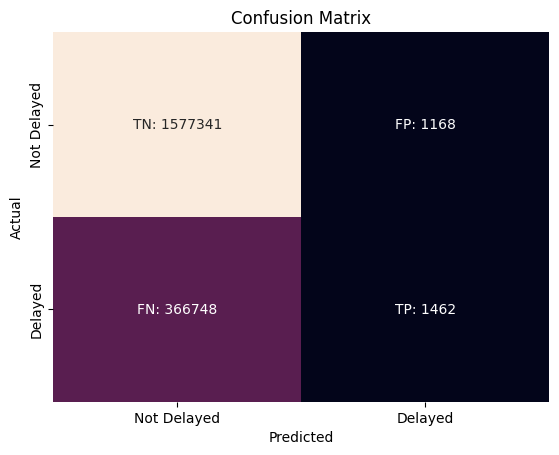

Precision: 0.5559
Recall: 0.0040
F1 Score: 0.0079
----------------------------------------
Metrics for RandomForestClassifier on Test Data:


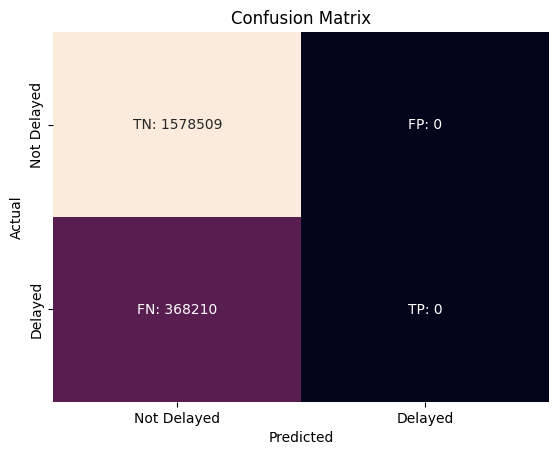

Precision: 0.0000
Recall: 0.0000
F1 Score: 0.0000
----------------------------------------
Metrics for MultilayerPerceptronClassifier on Test Data:


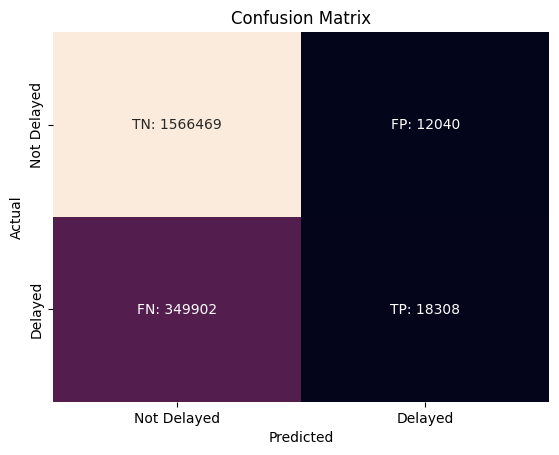

Precision: 0.6033
Recall: 0.0497
F1 Score: 0.0919
----------------------------------------


In [39]:
from pyspark.sql import functions as F
import numpy as np
import seaborn as sns

def compute_metrics(predictions, label_col="label", prediction_col="prediction", positive_class=1):
    # Create confusion matrix components
    tp = predictions.filter((F.col(label_col) == positive_class) & (F.col(prediction_col) == positive_class)).count()
    tn = predictions.filter((F.col(label_col) != positive_class) & (F.col(prediction_col) != positive_class)).count()
    fp = predictions.filter((F.col(label_col) != positive_class) & (F.col(prediction_col) == positive_class)).count()
    fn = predictions.filter((F.col(label_col) == positive_class) & (F.col(prediction_col) != positive_class)).count()

    # # Confusion matrix
    # print("Confusion Matrix:")
    # print(f"TP: {tp}, FP: {fp}")
    # print(f"FN: {fn}, TN: {tn}")

    confusion_matrix = np.array([[tn, fp], [fn, tp]])
    labels = np.array([[f"TN: {tn}", f"FP: {fp}"], [f"FN: {fn}", f"TP: {tp}"]])

    sns.heatmap(confusion_matrix, annot=labels, fmt="", cbar=False)
    plt.title("Confusion Matrix")
    plt.xlabel("Predicted")
    plt.ylabel("Actual")
    plt.xticks([0.5, 1.5], ["Not Delayed", "Delayed"])
    plt.yticks([0.5, 1.5], ["Not Delayed", "Delayed"])
    plt.show()


    # Precision, Recall, and F1 Score
    precision = tp / (tp + fp) if (tp + fp) > 0 else 0
    recall = tp / (tp + fn) if (tp + fn) > 0 else 0
    f1_score = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0

    print(f"Precision: {precision:.4f}")
    print(f"Recall: {recall:.4f}")
    print(f"F1 Score: {f1_score:.4f}")
    print("-" * 40)

# Iterate through all classifiers and calculate metrics
for name, preds in predictions.items():
    print(f"Metrics for {name} on Test Data:")
    compute_metrics(preds["test"], label_col="label", prediction_col="prediction", positive_class=1)



Feature Importances:
                          Feature  Importance
23                   DEP_TIME_BLK    0.259146
24                 DEP_BLOCK_HIST    0.236695
3                  SEGMENT_NUMBER    0.128576
15                           PRCP    0.106553
21               DEP_AIRPORT_HIST    0.088396
20             CARRIER_HISTORICAL    0.073266
22                 DAY_HISTORICAL    0.031379
16                           SNOW    0.024448
19                           AWND    0.010369
0                           MONTH    0.009565
8        AVG_MONTHLY_PASS_AIRPORT    0.008711
14                      LONGITUDE    0.004715
9        AVG_MONTHLY_PASS_AIRLINE    0.004378
7   AIRLINE_AIRPORT_FLIGHTS_MONTH    0.003665
6           AIRPORT_FLIGHTS_MONTH    0.003167
18                           TMAX    0.002389
13                       LATITUDE    0.001786
4              CONCURRENT_FLIGHTS    0.001656
5                 NUMBER_OF_SEATS    0.000434
10        FLT_ATTENDANTS_PER_PASS    0.000366
17           

C:\Users\RyanB\AppData\Local\Temp\ipykernel_13524\305255757.py:21: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=feature_importances_df, x="Importance", y="Feature", palette="viridis")


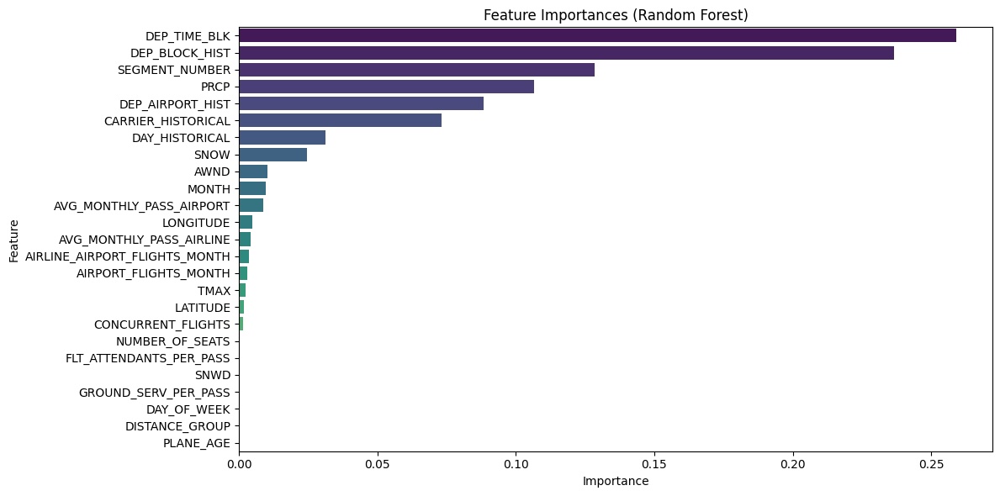

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Extract feature importances for Random Forest
rf_model = predictions["RandomForestClassifier"]["model"].stages[-1]  # Get the RandomForest stage
feature_importances = rf_model.featureImportances.toArray()

# Map feature importances to the feature names
feature_importances_df = pd.DataFrame({
    "Feature": numeric_features,  # List of feature names
    "Importance": feature_importances
}).sort_values(by="Importance", ascending=False)

# Print feature importances
print("Feature Importances:")
print(feature_importances_df)

# Plot feature importances
plt.figure(figsize=(12, 6))
sns.barplot(data=feature_importances_df, x="Importance", y="Feature", palette="viridis", hue="Importance")
plt.title("Feature Importances (Random Forest)")
plt.xlabel("Importance")
plt.ylabel("Feature")
plt.tight_layout()
plt.show()


Train Accuracy: 0.8109, Test Accuracy: 0.8109


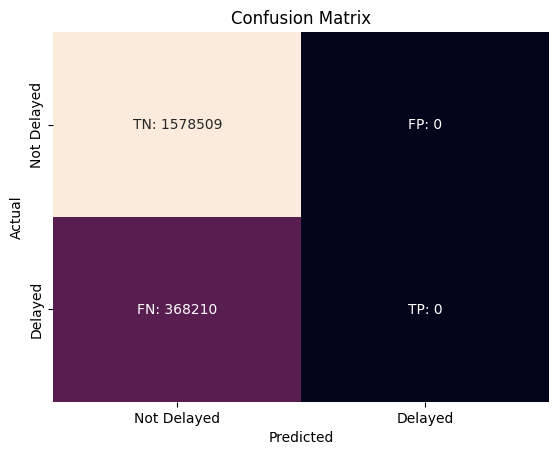

Precision: 0.0000
Recall: 0.0000
F1 Score: 0.0000
----------------------------------------


In [41]:
# Logistic regression with regParam 1 
lr2 = LogisticRegression(maxIter=10, regParam=1)

model_lr2, train_preds_lr2, test_preds_lr2 = train_and_evaluate(train_transformed, test_transformed, lr2)
compute_metrics(test_preds_lr2)

- Note that this model achieved 81% accuracy by simply classifying everything as 'Note Delayed'. This speaks to a major flaw of the dataset and our current methods: the data set doesn't have even distributions of each class in the target vector.

Train Accuracy: 0.8114, Test Accuracy: 0.8113


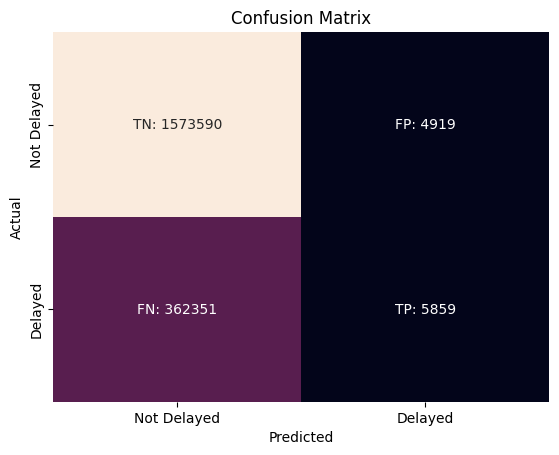

Precision: 0.5436
Recall: 0.0159
F1 Score: 0.0309
----------------------------------------


In [42]:
# Logistic regression with regParam 0.01
lr3 = LogisticRegression(maxIter=10, regParam=0.01)

model_lr3, train_preds_lr3, test_preds_lr3 = train_and_evaluate(train_transformed, test_transformed, lr3)
compute_metrics(test_preds_lr3)

Train Accuracy: 0.8114, Test Accuracy: 0.8113


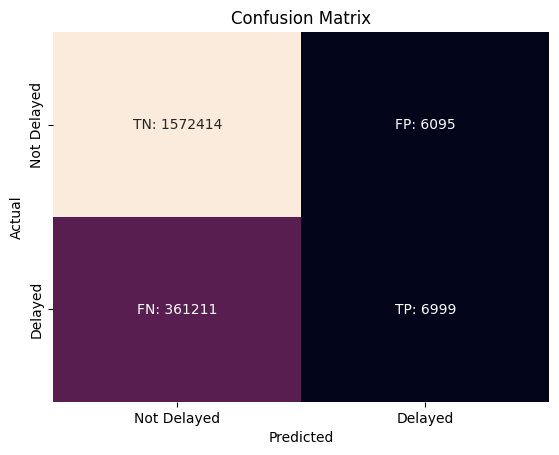

Precision: 0.5345
Recall: 0.0190
F1 Score: 0.0367
----------------------------------------


In [43]:
# Logistic regression with regParam 0.001
lr4 = LogisticRegression(maxIter=1000, regParam=0.001)

model_lr4, train_preds_lr4, test_preds_lr4 = train_and_evaluate(train_transformed, test_transformed, lr4)
compute_metrics(test_preds_lr4)

Train Accuracy: 0.8160, Test Accuracy: 0.8160


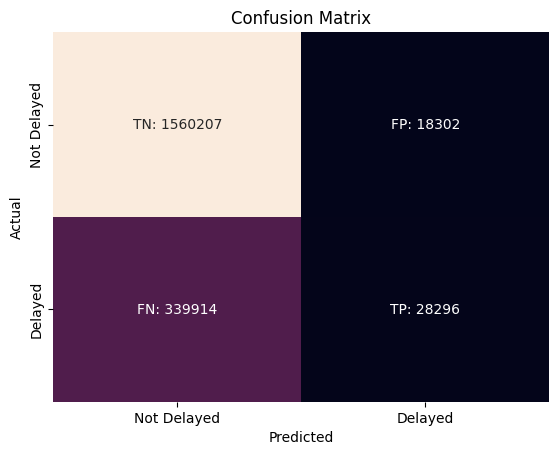

Precision: 0.6072
Recall: 0.0768
F1 Score: 0.1364
----------------------------------------


In [44]:
# mlp with more layers, more iterations, and smaller learning rate
mlp2 = MultilayerPerceptronClassifier(
    layers=[len(numeric_features), 50, 20, 2],  # Larger architecture
    maxIter=200,                               # More iterations
    stepSize=0.01,                             # Smaller learning rate
)

mlp2, train_preds_mlp2, test_preds_mlp2 = train_and_evaluate(train_transformed, test_transformed, mlp2)
compute_metrics(test_preds_mlp2)

{0.0: 1.0, 1.0: 4.286970499023463}
Train Accuracy: 0.5940, Test Accuracy: 0.5940


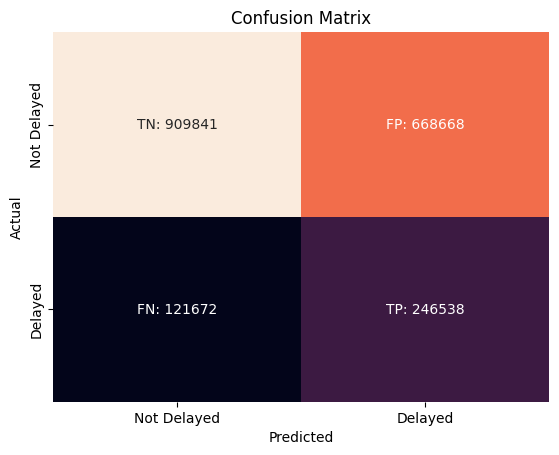

Precision: 0.2694
Recall: 0.6696
F1 Score: 0.3842
----------------------------------------


In [45]:
# Random forest with weightCol parameter
from pyspark.sql.functions import when, col

# Calculate weights for the classes
class_counts = train_transformed.groupBy("label").count().collect()
majority_class_count = max(row["count"] for row in class_counts)
weights = {row["label"]: majority_class_count / row["count"] for row in class_counts}
print(weights)

# Add weight column to the training data
train_data_weighted = train_transformed.withColumn("weight", when(col("label") == 1, weights[1]).otherwise(weights[0]))

# Use the weight column in the RandomForestClassifier
rf2 = RandomForestClassifier(numTrees=100, weightCol="weight")

# Train and evaluate
model_rf2, train_preds_rf2, test_preds_rf2 = train_and_evaluate(train_data_weighted, test_transformed, rf2)
compute_metrics(test_preds_rf2)


Train Accuracy: 0.8127, Test Accuracy: 0.8126


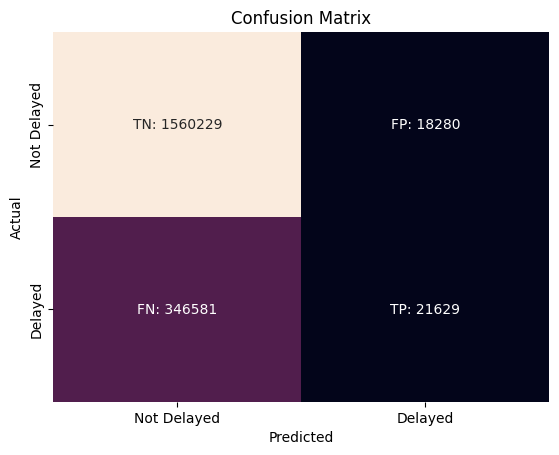

Precision: 0.5420
Recall: 0.0587
F1 Score: 0.1060
----------------------------------------


In [46]:
# Random forest with weightCol parameter, adjust weights
weights = {0: 1.0, 1: 2.0}  # Adjust weights to prioritize recall while maintaining precision

train_data_weighted = train_transformed.withColumn(
    "weight", when(col("label") == 1, weights[1]).otherwise(weights[0])
)

# Use the weight column in the RandomForestClassifier
rf3 = RandomForestClassifier(numTrees=100, weightCol="weight")

# Train and evaluate
model_rf3, train_preds_rf3, test_preds_rf3 = train_and_evaluate(train_data_weighted, test_transformed, rf3)
compute_metrics(test_preds_rf3)

Train Accuracy: 0.7528, Test Accuracy: 0.7532


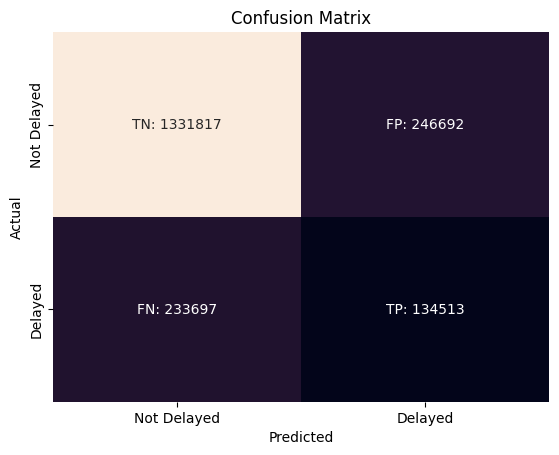

Precision: 0.3529
Recall: 0.3653
F1 Score: 0.3590
----------------------------------------


In [47]:
# Random forest with weightCol parameter, adjust weights
weights = {0: 1, 1: 3.0}  # Adjust weights to prioritize recall while maintaining precision

train_data_weighted = train_transformed.withColumn(
    "weight", when(col("label") == 1, weights[1]).otherwise(weights[0])
)

# Use the weight column in the RandomForestClassifier
rf3 = RandomForestClassifier(numTrees=100, weightCol="weight")

# Train and evaluate
model_rf3, train_preds_rf3, test_preds_rf3 = train_and_evaluate(train_data_weighted, test_transformed, rf3)
compute_metrics(test_preds_rf3)

In [48]:
# feature_importances = model_rf2.stages[-1].featureImportances

# # Example list of feature names
# feature_names = numeric_features  # Replace with your actual feature names list

# # Pair feature names with their importance
# feature_importance_dict = list(zip(feature_names, feature_importances))

# # Sort by importance (descending order)
# sorted_features = sorted(feature_importance_dict, key=lambda x: x[1], reverse=True)

# # Display
# for feature, importance in sorted_features:
#     print(f"{feature}: {importance}")

In [49]:
# weights = {0: 1, 1: 3.0}  # Adjust weights to prioritize recall while maintaining precision

# train_data_weighted = train_transformed.withColumn(
#     "weight", when(col("label") == 1, weights[1]).otherwise(weights[0])
# )

# # Use the weight column in the RandomForestClassifier
# rf3 = RandomForestClassifier(numTrees=100, maxDepth=15, featureSubsetStrategy="log2", weightCol="weight")

# # Train and evaluate
# model_rf3, train_preds_rf3, test_preds_rf3 = train_and_evaluate(train_data_weighted, test_transformed, rf3)
# compute_metrics(test_preds_rf3)

Feature Importances:
                          Feature  Importance
24                 DEP_BLOCK_HIST    0.293350
23                   DEP_TIME_BLK    0.269592
3                  SEGMENT_NUMBER    0.101320
20             CARRIER_HISTORICAL    0.086559
21               DEP_AIRPORT_HIST    0.084052
15                           PRCP    0.068765
22                 DAY_HISTORICAL    0.036365
8        AVG_MONTHLY_PASS_AIRPORT    0.008024
16                           SNOW    0.007704
19                           AWND    0.007270
9        AVG_MONTHLY_PASS_AIRLINE    0.007153
0                           MONTH    0.006362
6           AIRPORT_FLIGHTS_MONTH    0.005675
14                      LONGITUDE    0.004843
7   AIRLINE_AIRPORT_FLIGHTS_MONTH    0.002789
11           GROUND_SERV_PER_PASS    0.001819
18                           TMAX    0.001667
17                           SNWD    0.001496
13                       LATITUDE    0.001470
4              CONCURRENT_FLIGHTS    0.001300
5            

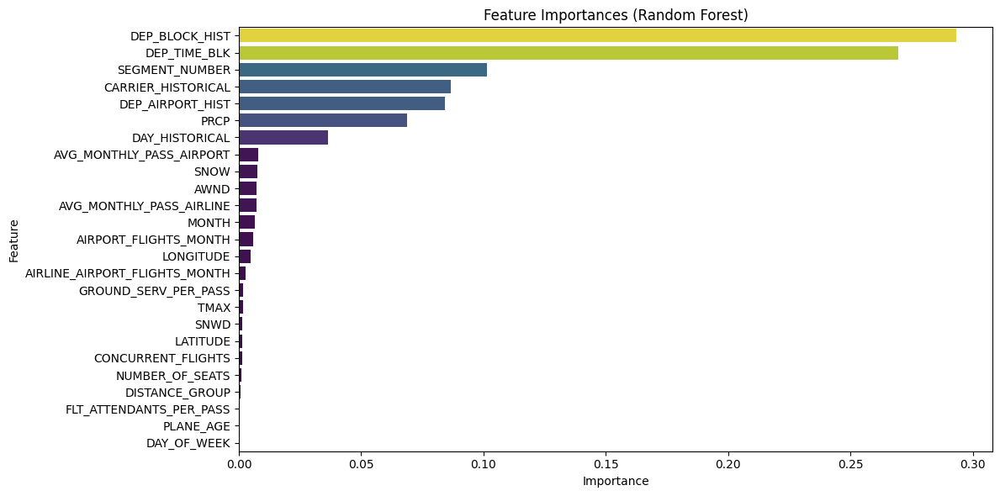

In [61]:
feature_importances = model_rf2.stages[-1].featureImportances.toArray()

# Map feature importances to the feature names
feature_importances_df = pd.DataFrame({
    "Feature": numeric_features,  # List of feature names
    "Importance": feature_importances
}).sort_values(by="Importance", ascending=False)

# Print feature importances
print("Feature Importances:")
print(feature_importances_df)

# Plot feature importances
plt.figure(figsize=(12, 6))
sns.barplot(data=feature_importances_df, x="Importance", y="Feature", palette="viridis", hue="Importance", legend=False)
plt.title("Feature Importances (Random Forest)")
plt.xlabel("Importance")
plt.ylabel("Feature")
plt.tight_layout()
plt.show()


## Hyperparameter tuning

In [51]:
from pyspark.ml import Pipeline
from pyspark.ml.tuning import CrossValidator, ParamGridBuilder
from pyspark.ml.classification import GBTClassifier
from pyspark.ml.evaluation import MulticlassClassificationEvaluator
from pyspark.mllib.evaluation import MulticlassMetrics

def cross_validate_and_evaluate(train_data, test_data, classifier, param_grid, evaluator, feature_col="numeric_features_scaled"):
    # Set up pipeline for each classifier
    classifier.setFeaturesCol(feature_col).setLabelCol("label")
    pipeline = Pipeline(stages=[classifier])

    # Cross-validation setup
    crossval = CrossValidator(estimator=pipeline,
                              estimatorParamMaps=param_grid,
                              evaluator=evaluator,
                              numFolds=5)  # 5-fold cross-validation

    # Fit the model
    cv_model = crossval.fit(train_data)

    # Best model from cross-validation
    best_model = cv_model.bestModel

    # Get best parameters
    best_params = {param.name: best_model._java_obj.getParam(param.name).json() for param in best_model.params}

    # Get predictions
    train_predictions = best_model.transform(train_data)
    test_predictions = best_model.transform(test_data)

    # Evaluate the model
    train_accuracy = evaluator.evaluate(train_predictions)
    test_accuracy = evaluator.evaluate(test_predictions)

    # Extract prediction and label columns for metrics
    train_labels_and_preds = train_predictions.select("label", "prediction").rdd
    test_labels_and_preds = test_predictions.select("label", "prediction").rdd

    # Compute confusion matrix
    train_metrics = MulticlassMetrics(train_labels_and_preds)
    test_metrics = MulticlassMetrics(test_labels_and_preds)

    # Get confusion matrix
    train_conf_matrix = train_metrics.confusionMatrix().toArray()
    test_conf_matrix = test_metrics.confusionMatrix().toArray()

    # Get precision, recall, and F1 score
    train_precision = train_metrics.precision()
    test_precision = test_metrics.precision()
    
    train_recall = train_metrics.recall()
    test_recall = test_metrics.recall()
    
    train_f1 = train_metrics.fMeasure()
    test_f1 = test_metrics.fMeasure()

    # Print results
    print(f"{classifier.__class__.__name__} - Best Parameters: {best_params}")
    print(f"{classifier.__class__.__name__} - Train Accuracy: {train_accuracy:.4f}, Test Accuracy: {test_accuracy:.4f}")
    print(f"{classifier.__class__.__name__} - Train Precision: {train_precision:.4f}, Test Precision: {test_precision:.4f}")
    print(f"{classifier.__class__.__name__} - Train Recall: {train_recall:.4f}, Test Recall: {test_recall:.4f}")
    print(f"{classifier.__class__.__name__} - Train F1 Score: {train_f1:.4f}, Test F1 Score: {test_f1:.4f}")
    print(f"{classifier.__class__.__name__} - Train Confusion Matrix:\n{train_conf_matrix}")
    print(f"{classifier.__class__.__name__} - Test Confusion Matrix:\n{test_conf_matrix}")

    return best_model, best_params, train_accuracy, test_accuracy, train_conf_matrix, test_conf_matrix, train_precision, test_precision, train_recall, test_recall




In [52]:
# # Logistic Regression Param Grid
# lr_param_grid = (ParamGridBuilder()
#                  .addGrid(lr.regParam, [0.1, 0.01])  # Regularization parameter
#                  .addGrid(lr.elasticNetParam, [0.0, 0.5, 1.0])  # ElasticNet parameter
#                  .build())

# # Random Forest Param Grid
# rf_param_grid = (ParamGridBuilder()
#                  .addGrid(rf.numTrees, [50, 100, 200])  # Number of trees
#                  .addGrid(rf.maxDepth, [5, 10, 20])  # Max depth
#                  .build())

# # Multilayer Perceptron Param Grid
# mlp_param_grid = (ParamGridBuilder()
#                   .addGrid(mlp.maxIter, [100, 200])  # Number of iterations
#                   .addGrid(mlp.layers, [[len(numeric_features), 10, 2], [len(numeric_features), 20, 2]])  # Layers structure
#                   .build())

# # Gradient Boosting Param Grid
# gbt_param_grid = (ParamGridBuilder()
#                   .addGrid(gbt.maxIter, [50, 100])  # Number of iterations
#                   .addGrid(gbt.maxDepth, [5, 10])  # Max depth
#                   .addGrid(gbt.stepSize, [0.05, 0.1])  # Step size (learning rate)
#                   .build())


In [53]:
# DIDNT RUN

# # Add GradientBoosting Classifier
# gbt = GBTClassifier()

# # Gradient Boosting Param Grid
# gbt_param_grid = (ParamGridBuilder()
#                   .addGrid(gbt.maxIter, [50, 100])  # Number of iterations
#                   .addGrid(gbt.maxDepth, [5, 10])  # Max depth
#                   .addGrid(gbt.stepSize, [0.05, 0.1])  # Step size (learning rate)
#                   .build())

# # Define evaluator for accuracy
# evaluator = MulticlassClassificationEvaluator(labelCol="label", predictionCol="prediction", metricName="accuracy")

# # Run cross-validation and hyperparameter tuning for GBT classifier
# best_model, best_params, train_accuracy, test_accuracy, train_conf_matrix, test_conf_matrix, train_precision, test_precision, train_recall, test_recall = cross_validate_and_evaluate(
#     train_transformed, test_transformed, gbt, gbt_param_grid, evaluator
# )

# # Print all the metrics
# print(f"Best Model: {best_model}")
# print(f"Best Parameters: {best_params}")
# print(f"Train Accuracy: {train_accuracy}")
# print(f"Test Accuracy: {test_accuracy}")
# print(f"Train Confusion Matrix:\n{train_conf_matrix}")
# print(f"Test Confusion Matrix:\n{test_conf_matrix}")
# print(f"Train Precision: {train_precision}")
# print(f"Test Precision: {test_precision}")
# print(f"Train Recall: {train_recall}")
# print(f"Test Recall: {test_recall}")

In [54]:
# # Define evaluator for accuracy
# evaluator = MulticlassClassificationEvaluator(labelCol="label", predictionCol="prediction", metricName="accuracy")

In [55]:
# # List of classifiers and their corresponding parameter grids
# classifiers = [lr, rf, mlp, gbt]
# param_grids = [lr_param_grid, rf_param_grid, mlp_param_grid, gbt_param_grid]

# # Run cross-validation and hyperparameter tuning
# best_models = cross_validate_and_evaluate(train_transformed, test_transformed, classifiers, param_grids, evaluator)


## See Features Importances for RF

In [56]:
# import numpy as np
# import pandas as pd

# # Convert the feature importances to a DataFrame for better readability
# importances = np.array(rf_model.featureImportances)
# feature_importance_df = pd.DataFrame({
#     'feature': numeric_features,
#     'importance': importances
# })

# # Sort by importance
# feature_importance_df = feature_importance_df.sort_values(by="importance", ascending=False)
# print(feature_importance_df)


## Adjust threshold

In [57]:
# from pyspark.sql.functions import col, when

# # Define a new decision threshold
# threshold = 0.3  # Lowering the threshold increases recall at the potential cost of precision

# # Adjust the decision threshold for Logistic Regression predictions
# lr_test_predictions = predictions["LogisticRegression"]["test"]
# lr_test_predictions_with_threshold = lr_test_predictions.withColumn(
#     "adjusted_prediction",
#     when(col("probability").getItem(1) > threshold, 1).otherwise(0)  # Positive class is at index 1
# )

# # Compute metrics with the adjusted threshold
# print("Metrics for Logistic Regression with Adjusted Threshold on Test Data:")
# compute_metrics(lr_test_predictions_with_threshold, label_col="label", prediction_col="adjusted_prediction")

# # Repeat for train data
# lr_train_predictions = predictions["LogisticRegression"]["train"]
# lr_train_predictions_with_threshold = lr_train_predictions.withColumn(
#     "adjusted_prediction",
#     when(col("probability").getItem(1) > threshold, 1).otherwise(0)
# )

# # Compute metrics for the train data
# print("Metrics for Logistic Regression with Adjusted Threshold on Train Data:")
# compute_metrics(lr_train_predictions_with_threshold, label_col="label", prediction_col="adjusted_prediction")



## Hyperparameter tuning using CrossValidator

In [58]:
# from pyspark.ml.tuning import CrossValidator, ParamGridBuilder

# # Define parameter grid for Logistic Regression
# paramGrid = ParamGridBuilder() \
#     .addGrid(lr.regParam, [0.01, 0.1, 1.0]) \
#     .addGrid(lr.elasticNetParam, [0.0, 0.5, 1.0]) \
#     .build()

# # CrossValidator
# crossval = CrossValidator(
#     estimator=Pipeline(stages=[lr]),
#     estimatorParamMaps=paramGrid,
#     evaluator=MulticlassClassificationEvaluator(metricName="accuracy"),
#     numFolds=3
# )

# # Fit cross-validation model
# cv_model = crossval.fit(train_transformed)

# # Get the best model
# best_lr_model = cv_model.bestModel

# # Evaluate the best model on the test data
# best_lr_test_predictions = best_lr_model.transform(test_transformed)
# print("Metrics for Best Logistic Regression Model from CrossValidator on Test Data:")
# compute_metrics(best_lr_test_predictions, label_col="label", prediction_col="prediction")

# # Evaluate the best model on the train data
# best_lr_train_predictions = best_lr_model.transform(train_transformed)
# print("Metrics for Best Logistic Regression Model from CrossValidator on Train Data:")
# compute_metrics(best_lr_train_predictions, label_col="label", prediction_col="prediction")
